<a href="https://colab.research.google.com/github/ahsansaeedakhtar/DeepLearningClass/blob/master/Assignment3_partA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#you'll need to sudo pip3 install gensim from a terminal, since the software 
#doesn't come with the deep learning ami. remember to use pip3 since this is a python3 notebook
import os
import gensim
import gensim.downloader as api
from gensim.models.word2vec import Word2Vec
import numpy as np

#gensim expects nltks word tokens, not strings
#sudo pip3 install nltk
from nltk import word_tokenize, FreqDist
import nltk
nltk.download('punkt')

import tensorflow as tf
from tensorflow.contrib.tensorboard.plugins import projector

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [2]:
#download rotten tomatoes reviews
!wget http://www.cs.cornell.edu/people/pabo/movie-review-data/review_polarity.tar.gz
    
#unzip
!tar xvzf review_polarity.tar.gz

--2019-09-16 21:37:38--  http://www.cs.cornell.edu/people/pabo/movie-review-data/review_polarity.tar.gz
Resolving www.cs.cornell.edu (www.cs.cornell.edu)... 132.236.207.20
Connecting to www.cs.cornell.edu (www.cs.cornell.edu)|132.236.207.20|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3127238 (3.0M) [application/x-gzip]
Saving to: ‘review_polarity.tar.gz’

review_polarity.tar 100%[===================>]   2.98M  3.92MB/s    in 0.8s    

2019-09-16 21:37:39 (3.92 MB/s) - ‘review_polarity.tar.gz’ saved [3127238/3127238]

txt_sentoken/neg/cv000_29416.txt
txt_sentoken/neg/cv001_19502.txt
txt_sentoken/neg/cv002_17424.txt
txt_sentoken/neg/cv003_12683.txt
txt_sentoken/neg/cv004_12641.txt
txt_sentoken/neg/cv005_29357.txt
txt_sentoken/neg/cv006_17022.txt
txt_sentoken/neg/cv007_4992.txt
txt_sentoken/neg/cv008_29326.txt
txt_sentoken/neg/cv009_29417.txt
txt_sentoken/neg/cv010_29063.txt
txt_sentoken/neg/cv011_13044.txt
txt_sentoken/neg/cv012_29411.txt
txt_sentoken/neg/cv0

In [3]:
#iterate over the reviews and add the data and label to X and y arrays.
tokenized_reviews = []
labels=[]

#for each sub_folder in the rotten tomatoes folder of reviews
for sub_folder in os.listdir('txt_sentoken'):
    #print the name of the sub_folder
    print (sub_folder)
    #for each file in the sub_folder
    for file in os.listdir('txt_sentoken/'+sub_folder):
        #print the name of the file
        print ('txt_sentoken/'+sub_folder+'/'+file)
        #open that file
        with open('txt_sentoken/'+sub_folder+'/'+file, 'r') as myfile:
            #read the file's data into memory
            data=myfile.read()
            #tokenize the string and save the tokenized content to the tokenized_reviews list
            tokenized_reviews.append(nltk.word_tokenize(data))
            #record the appropriate label for this data
            if sub_folder=='neg':
                labels.append(0)
            else:
                labels.append(1)

neg
txt_sentoken/neg/cv659_21483.txt
txt_sentoken/neg/cv281_24711.txt
txt_sentoken/neg/cv510_24758.txt
txt_sentoken/neg/cv282_6833.txt
txt_sentoken/neg/cv371_8197.txt
txt_sentoken/neg/cv326_14777.txt
txt_sentoken/neg/cv330_29675.txt
txt_sentoken/neg/cv967_5626.txt
txt_sentoken/neg/cv175_7375.txt
txt_sentoken/neg/cv171_15164.txt
txt_sentoken/neg/cv795_10291.txt
txt_sentoken/neg/cv093_15606.txt
txt_sentoken/neg/cv595_26420.txt
txt_sentoken/neg/cv354_8573.txt
txt_sentoken/neg/cv231_11028.txt
txt_sentoken/neg/cv202_11382.txt
txt_sentoken/neg/cv694_4526.txt
txt_sentoken/neg/cv183_19826.txt
txt_sentoken/neg/cv731_3968.txt
txt_sentoken/neg/cv324_7502.txt
txt_sentoken/neg/cv762_15604.txt
txt_sentoken/neg/cv367_24065.txt
txt_sentoken/neg/cv273_28961.txt
txt_sentoken/neg/cv506_17521.txt
txt_sentoken/neg/cv828_21392.txt
txt_sentoken/neg/cv230_7913.txt
txt_sentoken/neg/cv363_29273.txt
txt_sentoken/neg/cv669_24318.txt
txt_sentoken/neg/cv469_21998.txt
txt_sentoken/neg/cv826_12761.txt
txt_sentoken/ne

In [4]:
#the number of reviews we have from rotten tomatoes
print (len(tokenized_reviews))
#an example of tokenized data. this one below if the first rotten tomatoes review
print (len(tokenized_reviews[0]))
print (tokenized_reviews[0])

2000
841
['i', 'came', 'to', 'an', 'epiphany', 'while', 'watching', 'the', 'bachelor', ',', 'an', 'innocuous-enough-on-the-surface', 'romantic', 'comedy', '.', 'it', "'s", 'not', 'the', 'sort', 'of', 'film', 'in', 'which', 'one', 'would', 'expect', 'to', 'achieve', 'any', 'moment', 'of', 'clarity', ',', 'but', 'there', 'it', 'was', 'nonetheless', '.', 'i', 'sat', 'there', 'watching', 'this', 'marshmallow', 'of', 'a', 'movie', 'unfold', 'when', 'suddenly', 'i', 'realized', 'what', 'is', 'so', 'ridiculously', 'wrong', 'with', 'the', 'entire', 'romantic', 'comedy', 'genre', 'circa', '1999', '.', 'in', 'a', 'word', ',', 'it', "'s", 'the', 'same', 'thing', 'that', "'s", 'wrong', 'with', 'so', 'many', 'movies', 'circa', '1999', ':', 'writing', '.', 'more', 'to', 'the', 'point', ',', 'it', "'s", 'the', 'refusal', 'to', 'acknowledge', 'that', 'characterizations', 'matter', 'when', 'you', "'re", 'telling', 'a', 'story', 'about', 'a', 'relationship', '.', 'the', 'bachelor', 'is', 'merely', 'the'

In [5]:
#nltk api exploration
saying=['After','all','is','said','and','done','more','is','said','than','done']
#only unique words in a set
tokens=set(saying)
#sort those unique words in alphabetical order
tokens=sorted(tokens)
print (tokens)
#and print the 2nd to last word in alphabetical order
print (tokens[-2])
print()

['After', 'all', 'and', 'done', 'is', 'more', 'said', 'than']
said



the first review has 298 unique words and 698 total words
<FreqDist with 394 samples and 841 outcomes>

printing the top 10 most common words
[('the', 40), ('.', 33), (',', 30), ('a', 25), ("'s", 24), ('of', 21), ('to', 20), ('and', 13), ('it', 12), ('is', 11)]

sample with the greatest count the

frequency of the word "that" 10

cumulative frequency chart of the top 25 most common words


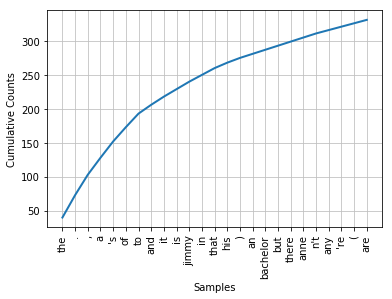

In [6]:
#back to our rotten tomatoes data

#make an nltk frequency distribution object
fdist1 = FreqDist(tokenized_reviews[0])
print('the first review has 298 unique words and 698 total words')
print (fdist1)

#fdist1.keys() returns the samples sorted in order of decreasing frequency
print ('\nprinting the top 10 most common words')
print (fdist1.most_common(10))

print ('\nsample with the greatest count '+fdist1.max())

print ('\nfrequency of the word "that" '+str(fdist1['that']))
print ('\ncumulative frequency chart of the top 25 most common words')
fdist1.plot(25, cumulative=True)

In [7]:
# build vocabulary and train gensim word2vec model
model = gensim.models.Word2Vec(
    tokenized_reviews,
    size=150,
    window=10,
    min_count=2,
    workers=10)
model.train(tokenized_reviews, total_examples=len(tokenized_reviews), epochs=10)

#number of distinct words
print (len(model.wv.vocab))

#gensim api exploration: https://radimrehurek.com/gensim/models/word2vec.html
print ('five most similar words to the entered word')
print (model.wv.most_similar(positive=['she'], topn=5))
print ('\nsimilarity score between the two entered words')
print (model.wv.similarity(w1='good',w2='great'))
print ('\nthe embedding for the entered word')
print (model.wv['she'])

print ('\ncount frequency of the entered word')
print (model.wv.vocab["she"].count)

27070
five most similar words to the entered word
[('her', 0.672518789768219), ('herself', 0.6163026094436646), ('millie', 0.5802106261253357), ('woman', 0.5764557719230652), ('martha', 0.5456419587135315)]

similarity score between the two entered words
0.65065354

the embedding for the entered word
[-8.91709268e-01 -3.78795815e+00 -8.44966531e-01 -3.50740266e+00
  2.45515060e+00  4.94294596e+00 -9.77976859e-01 -2.89231038e+00
  4.90552336e-01  4.62277770e-01  1.77961087e+00  3.14902401e+00
  3.43683195e+00  4.69786584e-01  7.96269834e-01  2.26358414e+00
 -3.15319687e-01  3.18309665e+00 -2.51521087e+00 -5.53767383e-01
  3.66680324e-01 -3.18548512e+00  2.92460471e-02 -1.77167737e+00
  5.63953817e-01 -6.38486266e-01 -1.46048522e+00  4.46910954e+00
 -3.21583200e+00 -1.58840179e+00 -7.66253352e-01  5.63474119e-01
  1.10170960e+00 -5.32753021e-02  1.01206875e+00  1.08528769e+00
 -7.46282876e-01 -5.70433177e-02  2.39855266e+00 -1.01491630e-01
  2.11417407e-01 -1.76535547e+00 -2.83810925e+00

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if np.issubdtype(vec.dtype, np.int):


In [8]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [9]:
#now that we have our embeddings, it's time to send them to tensorflow/tensorboard



def visualize(model, output_path):
    meta_file = "w2x_metadata.tsv"
    placeholder = np.zeros((len(model.wv.index2word), 150))

    with open(os.path.join(output_path,meta_file), 'wb') as file_metadata:
        for i, word in enumerate(model.wv.index2word):
            placeholder[i] = model[word]
            # temporary solution for https://github.com/tensorflow/tensorflow/issues/9094
            if word == '':
                print("Emply Line, should replecaed by any thing else, or will cause a bug of tensorboard")
                file_metadata.write("{0}".format('<Empty Line>').encode('utf-8') + b'\n')
            else:
                file_metadata.write("{0}".format(word).encode('utf-8') + b'\n')

    # define the model without training
    sess = tf.InteractiveSession()

    embedding = tf.Variable(placeholder, trainable = False, name = 'w2x_metadata')
    tf.global_variables_initializer().run()

    saver = tf.train.Saver()
    writer = tf.summary.FileWriter(output_path, sess.graph)

    # adding into projector
    config = projector.ProjectorConfig()
    embed = config.embeddings.add()
    embed.tensor_name = 'w2x_metadata'
    embed.metadata_path = meta_file

    # Specify the width and height of a single thumbnail.
    projector.visualize_embeddings(writer, config)
    saver.save(sess, os.path.join(output_path,'w2x_metadata.ckpt'))
    print('Run `tensorboard --logdir={0}` to run visualize result on tensorboard'.format(output_path))


try:
    output_path  = '/content/gdrive/My Drive/'
except:
    print("Please provice model path and output path")
visualize(model, output_path)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  # Remove the CWD from sys.path while we load stuff.


Run `tensorboard --logdir=/content/gdrive/My Drive/` to run visualize result on tensorboard


In [16]:
%load_ext tensorboard
%tensorboard --logdir='/content/gdrive/My Drive/'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Take a screenshot of your Tensorboard embeddings running on your EC2 instance and paste that photo here. You will need to port forward into tensorboard's default port of 6006 in the same way that you did to Jupyter's 8888.

The following instructional links may also help:
- https://angus.readthedocs.io/en/2014/amazon/transfer-files-between-instance.html
- https://stackoverflow.com/questions/32370281/how-to-include-image-or-picture-in-jupyter-notebook